In [1]:
# Import libraries
import numpy as np
try:
    from astropy.io import fits
except ImportError:
    print("Warning: Astropy is not installed but is necessay for the code to run.")
    
import matplotlib.pyplot as plt

# Local modules
from Solver import solve_field

from Visualization import plot_stellar
from Visualization import compare_hashes
from Visualization import visualize_with_wcs

from StarDetection import extract_stars

from AsterismBuilder import build_asterisms_from_input_image
from AsterismBuilder import build_asterisms_from_GAIA

from IndexHandler import get_index

### Introduction

This project consists of roughly 850 lines of code, including comments and documentation. Because of this, it has been split into multiple files. This file serves as the main example of how to use the code, and to generate supporting figures. Secondarily the main file is the Solver.py which contains the `solve_field` command which calls the other modules to e.g. extract stars, get an appropriate index file, do the visualizations and more. While this command is all that is required to solve a field, this document will take a more step-by-step approach to show the steps involved.

The code is written in Python 3.9.13, and the following (non-trivial) packages are required to run it:
- Astropy
- Photutils
- Skimage/sklearn

### Import data and show it

The first step is to import the data. The data is in the `fits` format, which consists of a Header Display Unit List (HDUL), which may contain a number of Header Display Units (HDU). Each HDU contains image data and metadata. For the FUT, the relevant information is in the first HDU of the HDUL:

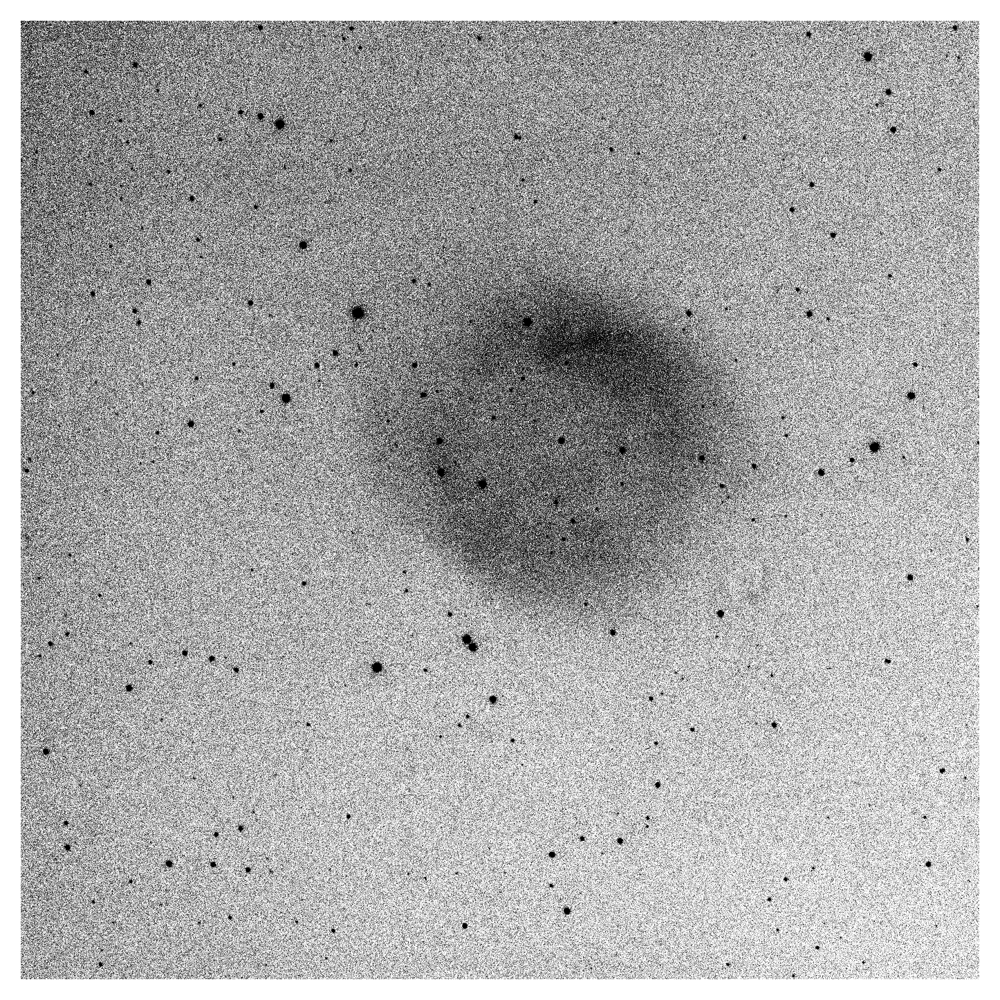

In [2]:
# Import helix image
hdul = fits.open("Data/helix-nebula.fits")
hdu = hdul[0]
image_data = hdu.data

# Get rough coordinates from metadata, stored in the "header" of the HDU
approx_ra, approx_dec = hdu.header['OBJ-RA'], hdu.header['OBJ-DEC']

# Show the image (clipping the histogram to show more detail)
fig,ax = plot_stellar(image_data,vlims=[15,98])
fig.savefig('Figures/helix-nebula-raw.jpeg',dpi=300)

### Extract stars

The star extraction algorithm is contained in the `StarDetection.py` file, and can be called using the `extract_stars` method.

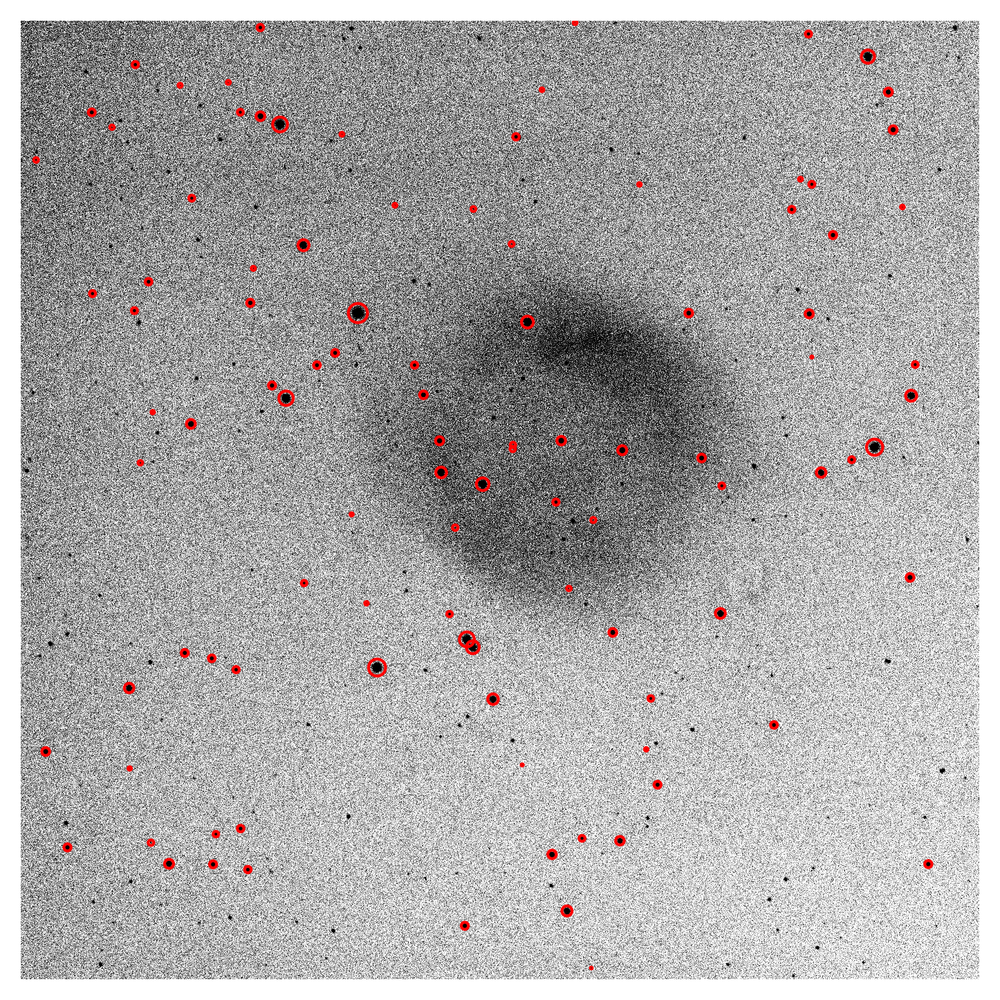

In [3]:
# Get the stars
stars = extract_stars(image_data)

# Illustrate the stars
fig,ax = plot_stellar(image_data,vlims=[15,98])
ax.scatter(stars['x'],stars['y'],s=stars['flux']**(0.5)*2e-2, facecolors='none', edgecolors='r')
# Scales the size of the points by the flux so brighter stars are bigger
fig.savefig('Figures/helix-nebula-stars.jpeg',dpi=300)

### Build asterisms from image

First step is to build asterisms from the stars detected above. Only a subset of the brightest stars are used to build asterisms, namely $n=\rho_f A_f$, where $\rho_f$ is the field density (algorithm parameter) and $A_f$ is the field area.

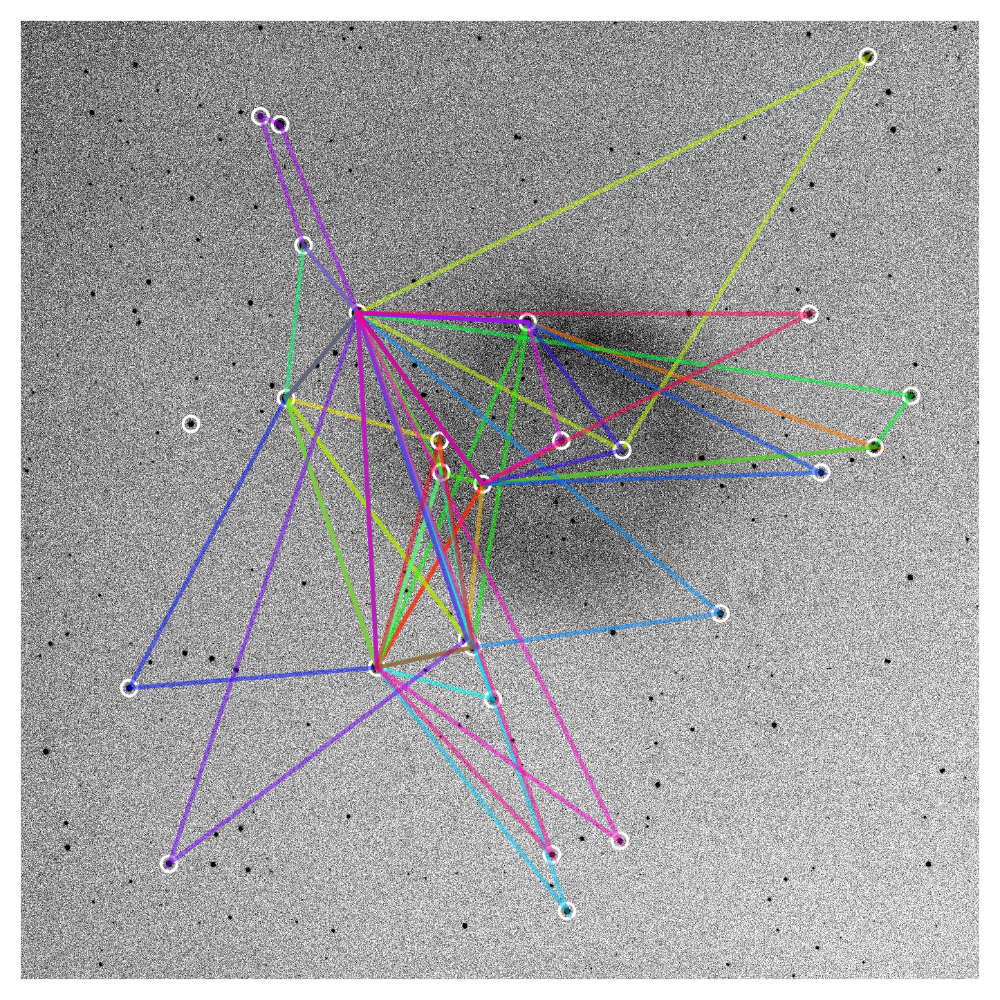

In [4]:
asterisms,hashes_IMAGE,fig,ax = build_asterisms_from_input_image(hdul,visualize=True)
fig.savefig('Figures/helix-nebula-asterisms.jpeg',dpi=300)

### Build index from GAIA DR2

The code uses the GAIA DR2 catalog to build an index of asterisms. The code uses a caching system so that the database is not queried again if data already exists that is close to the requested data. Because fetching data from the GAIA database is slow, I included the necessary for this example (found in the GAIACache folder). However, if this data was removed, the code would automatically fetch it again.

Checking cache entries ...
Found relevant cache entry: ./GAIACache/337.41_-20.84_FD100.00_SRM2.00.votable.gz.
Using cached GAIA results.


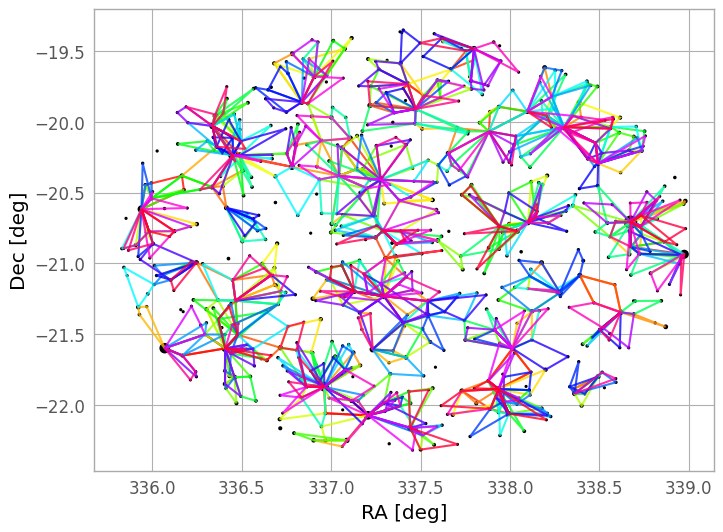

In [5]:
# First get some stars from the index
gaia_stars = get_index(hdul,approx_ra,approx_dec)

# Then build asterisms from those stars
asterisms,hashes_GAIA,fig,ax = build_asterisms_from_GAIA(gaia_stars,visualize=True)
fig.savefig('Figures/helix-nebula-asterisms-gaia.jpeg',dpi=300)

### Solve the field

Now that all the consituent parts are in place, the field can be solved. For this, I will just use the solve_field commands which actually does all the steps above in the background.

In [6]:
sol = solve_field(hdul,approx_ra,approx_dec)

Checking cache entries ...
Found relevant cache entry: ./GAIACache/337.41_-20.84_FD100.00_SRM2.00.votable.gz.
Using cached GAIA results.
Matching hashes... Match found! Bayes factor: 6.88e+06


So it seems a match was found! Let's see what the matched asterisms look like:

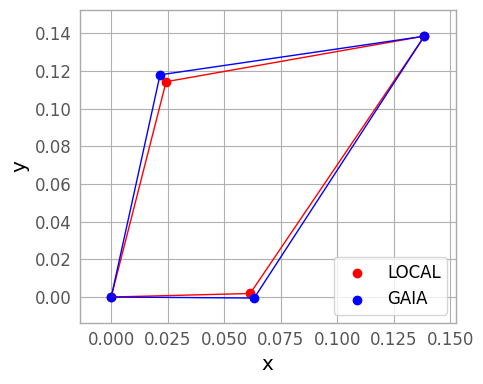

In [7]:
fig,ax = compare_hashes(sol['local_hash'],sol['gaia_hash'])
fig.savefig('Figures/helix-nebula-hash-comparison.jpeg',dpi=300)

The matched asterisms look pretty similar!

### Visualize the image with new WCS

Now that we have a valid WCS, we can show the image in physical coordinates (here shown with both equatorial and Galactic coordinates).

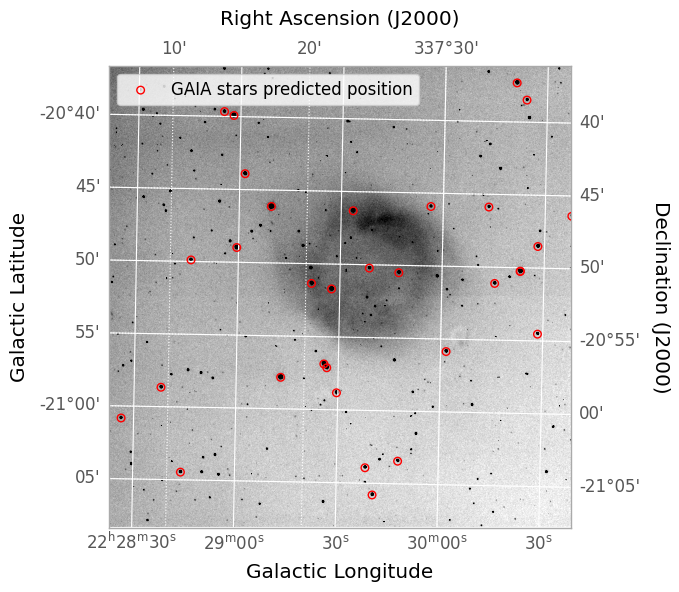

In [8]:
# Get the image projected into physical coordinates
fig,ax = visualize_with_wcs(image_data,sol['wcs'],vlims=[15,98])

# Let's add the GAIA stars just to show that they are in the right place
gaia_stars_x,gaia_stars_y = sol['wcs'].all_world2pix(gaia_stars['ra'],gaia_stars['dec'],0)
ax.scatter(gaia_stars_x,gaia_stars_y,color='r',s=30,label='GAIA stars predicted position',facecolors='none',edgecolors='r')
ax.legend()
fig.savefig('Figures/helix-nebula-wcs.jpeg',dpi=300)